<a href="https://colab.research.google.com/github/ChaaruVijay/DSPL-CourseWork/blob/main/Finalized_Traincsv.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

**Train CSV**

**Data Exploration**

In [1]:
import pandas as pd
import plotly.express as px
import seaborn as sns
import matplotlib.pyplot as plt
import numpy as np

In [ ]:
#read the csv
train = pd.read_csv("/content/traincsv.csv")
train

<ipython-input-2-658cef5547d6>:2: DtypeWarning: Columns (2,3,4,5) have mixed types. Specify dtype option on import or set low_memory=False.
  train = pd.read_csv("/content/traincsv.csv")


,Customer_ID,outlet_city,luxury_sales,fresh_sales,dry_sales,cluster_catgeory
0,10493832,Kelaniya,1209.6,756.0,5292.0,4
1,10178643,Moratuwa,1590.12,1060.08,6007.12,1
2,10513916,Wattala,2288.88,1481.04,9155.52,4
3,10334589,Wattala,2274.94,1739.66,9099.76,4
4,10458365,Kelaniya,2345.49,2069.55,9243.99,4
...,...,...,...,...,...,...
490771,10732227,Gampaha,1765.4,3530.8,11475.1,1.0
490772,10577974,Colombo,2649.64,3406.68,12869.68,1.0
490773,10016066,Negombo,1556.3,2645.71,10582.84,1.0
490774,10289987,Gampaha,1735.58,2524.48,10255.7,1.0


In [ ]:
train.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 490776 entries, 0 to 490775
Data columns (total 6 columns):
 #   Column            Non-Null Count   Dtype 
---  ------            --------------   ----- 
 0   Customer_ID       490776 non-null  int64 
 1   outlet_city       490776 non-null  object
 2   luxury_sales      490758 non-null  object
 3   fresh_sales       490758 non-null  object
 4   dry_sales         490761 non-null  object
 5   cluster_catgeory  490775 non-null  object
dtypes: int64(1), object(5)
memory usage: 22.5+ MB


In [ ]:
train.describe(include='all')

,Customer_ID,outlet_city,luxury_sales,fresh_sales,dry_sales,cluster_catgeory
count,4.907760e+05,490776,490758,490758.0,490761.0,490775.0
unique,NaN,20,150503,197695.0,179481.0,16.0
top,NaN,Peliyagoda,1029.6,1018.8,5085.3,2.0
freq,NaN,37151,38,23.0,21.0,155049.0
mean,1.038719e+07,NaN,NaN,NaN,NaN,NaN
std,2.236107e+05,NaN,NaN,NaN,NaN,NaN
min,1.000000e+07,NaN,NaN,NaN,NaN,NaN
25%,1.019338e+07,NaN,NaN,NaN,NaN,NaN
50%,1.038728e+07,NaN,NaN,NaN,NaN,NaN
75%,1.058108e+07,NaN,NaN,NaN,NaN,NaN


In [ ]:
train.shape

(490776, 6)

In [ ]:
unique_inputs_train = train.apply(pd.Series.unique)
print(unique_inputs_train)

Customer_ID         [10493832, 10178643, 10513916, 10334589, 10458...
outlet_city         [Kelaniya, Moratuwa, Wattala, Homagama, Dehiwa...
luxury_sales        [1209.6, 1590.12, 2288.88, 2274.94, 2345.49, 1...
fresh_sales         [756.0, 1060.08, 1481.04, 1739.66, 2069.55, 91...
dry_sales           [5292.0, 6007.12, 9155.52, 9099.76, 9243.99, 5...
cluster_catgeory    [4, 1, 99, 2, 5, 3, 6, 6\, 4, 2, 1, 95, 3, 98,...
dtype: object


In [ ]:
train.duplicated().sum()

0

In [ ]:
train.isnull().sum()

,0
Customer_ID,0
outlet_city,0
luxury_sales,18
fresh_sales,18
dry_sales,15
cluster_catgeory,1


In [ ]:
#convert the strings to numeric value
train['luxury_sales'] = pd.to_numeric(train['luxury_sales'], errors='coerce').astype(float)
train['fresh_sales'] = pd.to_numeric(train['fresh_sales'], errors='coerce').astype(float)
train['dry_sales'] = pd.to_numeric(train['dry_sales'], errors='coerce').astype(float)

UNIVARIATE ANALYSIS

Histograms

In [ ]:
#histogram of fresh sales
fig = px.histogram(train, x='fresh_sales', nbins=30, title=f"Distribution of 'fresh_sales'")
fig.show()

In [ ]:
#histogram of luxury sales
fig = px.histogram(train, x='luxury_sales', nbins=30, title=f"Distribution of 'Luxury Sales'")
fig.show()

In [ ]:
#histogram of dry sales
fig = px.histogram(train, x='dry_sales', nbins=30, title=f"Distribution of 'Dry Sales'")
fig.show()

Box Plots

In [ ]:
#Box plots of dry sales
fig1 = px.box(train, y="dry_sales", title="Box Plot of Dry Sales")
fig1.show()

In [ ]:
#Box plots of luxury sales
fig2 = px.box(train, y="luxury_sales", title="Box Plot of Luxury Sales")
fig2.show()

In [ ]:
#Box plots of fresh sales
fig3 = px.box(train, y="fresh_sales", title="Box Plot of Fresh Sales")
fig3.show()

MULTIVARIATE ANALYSIS

In [ ]:
#Correlation Analysis
corr_matrix = train[['luxury_sales', 'fresh_sales', 'dry_sales']].corr()
fig = px.imshow(corr_matrix, text_auto=True, color_continuous_scale=px.colors.sequential.Viridis,
                title="Correlation Heatmap")
fig.show()

In [ ]:
#Sales by City
city_sales = train.groupby('outlet_city')[['luxury_sales', 'fresh_sales', 'dry_sales']].sum().reset_index()
fig = px.bar(city_sales, x='outlet_city', y=['luxury_sales', 'fresh_sales', 'dry_sales'],
             title="Sales by City", barmode='group')
fig.show()

/usr/local/lib/python3.11/dist-packages/IPython/core/pylabtools.py:151: UserWarning:

Creating legend with loc="best" can be slow with large amounts of data.



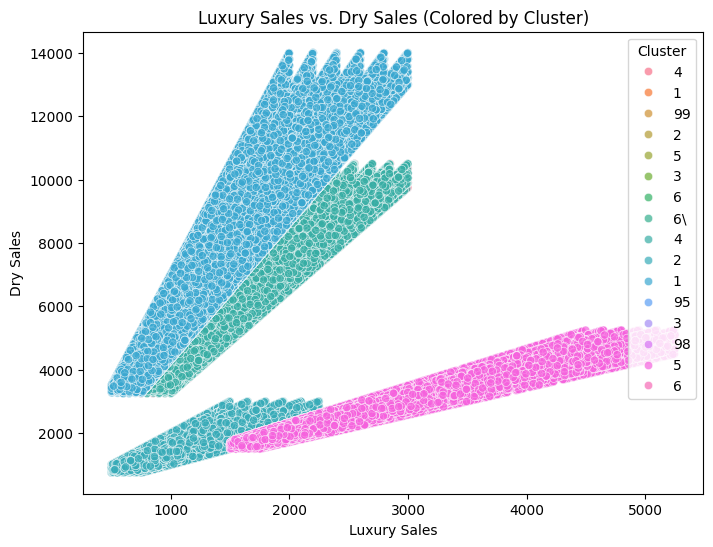

In [ ]:
# Create the scatter plot
plt.figure(figsize=(8, 6))
sns.scatterplot(data=train, x="luxury_sales", y="dry_sales", hue="cluster_catgeory", alpha=0.7)
plt.legend(title="Cluster")
plt.title("Luxury Sales vs. Dry Sales (Colored by Cluster)")
plt.xlabel("Luxury Sales")
plt.ylabel("Dry Sales")
plt.legend(title="Cluster")
plt.show()

Data Cleaning

**Data cleaning Tasks** :
Handling missing values.
Correcting data entry errors.
Standardizing data formats.
Encoding categorical variables.
Removing duplicates or irrelevant data.

Customer ID

In [ ]:
#Identifying missing rows in customerId
missing_index = train[train['Customer_ID'].isna()].index
missing_index

Index([], dtype='int64')

In [ ]:
missing_percentage = (train['Customer_ID'].isna().sum() / len(train)) * 100
print(f"Missing Percentage: {missing_percentage:.2f}%")

Missing Percentage: 0.00%


In [ ]:
# Remove rows with missing values in customerId
train = train.dropna()

Outlets

In [ ]:
#read the test csv
test = pd.read_csv("/content/traincsv.csv")
test

<ipython-input-23-6a9d0d01b210>:2: DtypeWarning:

Columns (3,4,5) have mixed types. Specify dtype option on import or set low_memory=False.



,Customer_ID,outlet_city,luxury_sales,fresh_sales,dry_sales,cluster_catgeory
0,10493832.0,Kelaniya,1209.6,756.0,5292.0,4
1,10178643.0,Moratuwa,1590.12,1060.08,6007.12,1
2,10513916.0,Wattala,2288.88,1481.04,9155.52,4
3,10334589.0,Wattala,2274.94,1739.66,9099.76,4
4,10458365.0,Kelaniya,2345.49,2069.55,9243.99,4
...,...,...,...,...,...,...
774150,10197979.0,Gampaha,3893.4,3893.4,3448.44,3
774151,10494575.0,Katunayake,6095.86,5557.99,6275.15,3
774152,10565682.0,Colombo,5121.42,4820.16,4669.53,3
774153,10351977.0,Kandy,6311.76,6311.76,5940.48,3


In [ ]:
#Identifying unique Ids in test
test["outlet_city"].unique()

array(['Kelaniya', 'Moratuwa', 'Wattala', 'Homagama',
       'Dehiwala-Mount Lavinia', 'Panadura', 'Kaduwela', 'Peliyagoda',
       'Kotte', 'Nuwara Eliya', 'Batticaloa', 'Colombo', 'Jaffna',
       'Gampaha', 'Kalmunai', 'Galle', 'Katunayake', 'Negombo',
       'Trincomalee', 'Kandy', nan], dtype=object)

In [ ]:
from sklearn.preprocessing import LabelEncoder

# Initialize label encoder
le = LabelEncoder()

# Fit and transform the outlet_city column
train['outlet_city'] = le.fit_transform(train['outlet_city'])

# Check encoding
print(train[['outlet_city']].head())

   outlet_city
0           11
1           13
2           19
3           19
4           11


<ipython-input-25-bb5406b5010c>:7: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy



In [ ]:
train['outlet_city'].unique()

array([11, 13, 19,  5,  2, 16,  7, 17, 12, 15,  0,  1,  6,  4,  8,  3, 10,
       14, 18,  9])

Luxury sales

In [ ]:
# Convert numeric values stored as strings to float
train['luxury_sales'] = pd.to_numeric(train['luxury_sales'], errors='coerce')
train['luxury_sales'].dtype

<ipython-input-27-6ba52e06a190>:2: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy



dtype('float64')

In [ ]:
train.isna().sum()

,0
Customer_ID,0
outlet_city,0
luxury_sales,0
fresh_sales,0
dry_sales,0
cluster_catgeory,0


<Axes: xlabel='luxury_sales', ylabel='Count'>

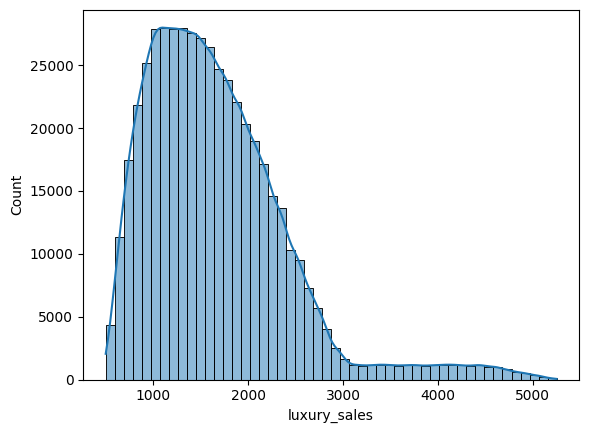

In [ ]:
#checking the destribution of the data
import seaborn as sns
sns.histplot(train['luxury_sales'], bins=50, kde=True)

Since its right skewwed using the median approah.

In [ ]:
train['luxury_sales'].fillna(train['luxury_sales'].median(), inplace=True)

<ipython-input-30-722a16d15c84>:1: FutureWarning:

A value is trying to be set on a copy of a DataFrame or Series through chained assignment using an inplace method.
The behavior will change in pandas 3.0. This inplace method will never work because the intermediate object on which we are setting values always behaves as a copy.

For example, when doing 'df[col].method(value, inplace=True)', try using 'df.method({col: value}, inplace=True)' or df[col] = df[col].method(value) instead, to perform the operation inplace on the original object.



<ipython-input-30-722a16d15c84>:1: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy



In [ ]:
train.isnull().sum()

,0
Customer_ID,0
outlet_city,0
luxury_sales,0
fresh_sales,0
dry_sales,0
cluster_catgeory,0


Fresh Sales

In [ ]:
# Convert numeric values stored as strings to float
train['fresh_sales'] = pd.to_numeric(train['fresh_sales'], errors='coerce')
train['fresh_sales'].dtype

<ipython-input-32-c2b5bebef66e>:2: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy



dtype('float64')

In [ ]:
train.isnull().sum()

,0
Customer_ID,0
outlet_city,0
luxury_sales,0
fresh_sales,0
dry_sales,0
cluster_catgeory,0


<Axes: xlabel='fresh_sales', ylabel='Count'>

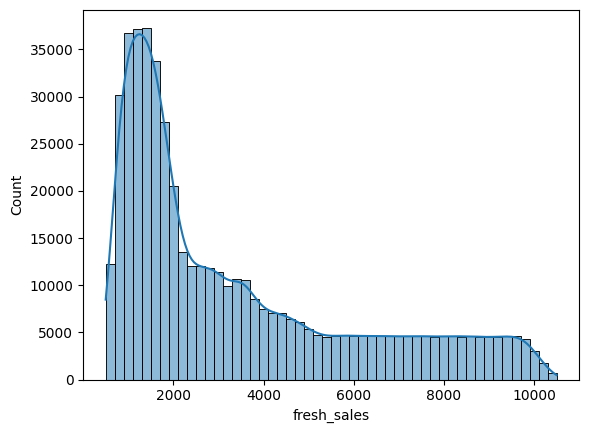

In [ ]:
#checking the destribution of the data
import seaborn as sns
sns.histplot(train['fresh_sales'], bins=50, kde=True)

In [ ]:
train['fresh_sales'].fillna(train['fresh_sales'].median(), inplace=True)

<ipython-input-35-fce729a411ac>:1: FutureWarning:

A value is trying to be set on a copy of a DataFrame or Series through chained assignment using an inplace method.
The behavior will change in pandas 3.0. This inplace method will never work because the intermediate object on which we are setting values always behaves as a copy.

For example, when doing 'df[col].method(value, inplace=True)', try using 'df.method({col: value}, inplace=True)' or df[col] = df[col].method(value) instead, to perform the operation inplace on the original object.



<ipython-input-35-fce729a411ac>:1: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy



Dry Sales

In [ ]:
# Convert numeric values stored as strings to float
train['dry_sales'] = pd.to_numeric(train['dry_sales'], errors='coerce') # Changed 'df' to 'train'
train['dry_sales'].dtype

<ipython-input-36-94f5c4033ae6>:2: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy



dtype('float64')

<Axes: xlabel='dry_sales', ylabel='Count'>

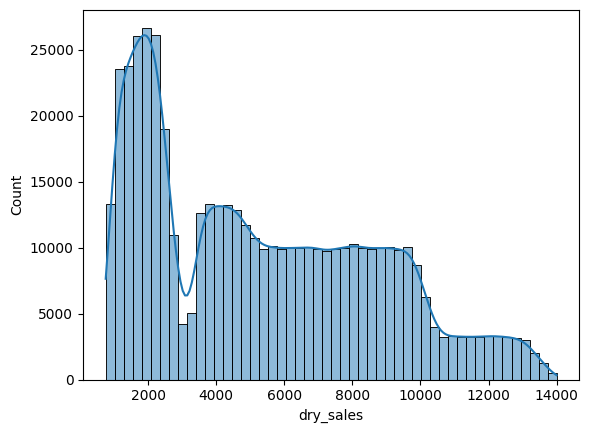

In [ ]:
#checking the destribution of the data
import seaborn as sns
sns.histplot(train['dry_sales'], bins=50, kde=True)

In [ ]:
train['dry_sales'].fillna(train['dry_sales'].median(), inplace=True)

<ipython-input-38-b485c19bb8c3>:1: FutureWarning:

A value is trying to be set on a copy of a DataFrame or Series through chained assignment using an inplace method.
The behavior will change in pandas 3.0. This inplace method will never work because the intermediate object on which we are setting values always behaves as a copy.

For example, when doing 'df[col].method(value, inplace=True)', try using 'df.method({col: value}, inplace=True)' or df[col] = df[col].method(value) instead, to perform the operation inplace on the original object.



<ipython-input-38-b485c19bb8c3>:1: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy



In [ ]:
# Convert numeric values stored as strings to float
train['cluster_catgeory'] = pd.to_numeric(train['cluster_catgeory'], errors='coerce')
train['cluster_catgeory'].dtype

<ipython-input-39-7b7764c39543>:2: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy



dtype('float64')

In [ ]:
train.describe()

,Customer_ID,outlet_city,luxury_sales,fresh_sales,dry_sales,cluster_catgeory
count,4.907190e+05,490719.000000,490719.000000,490719.000000,490719.000000,490718.000000
mean,1.038719e+07,10.593227,1664.501766,3383.393860,5309.581590,2.692921
std,2.236121e+05,5.623715,752.400647,2650.714256,3347.554832,1.399434
min,1.000000e+07,0.000000,500.000000,500.000000,750.150000,1.000000
25%,1.019338e+07,5.000000,1120.210000,1333.645000,2167.740000,1.000000
50%,1.038728e+07,12.000000,1541.280000,2245.440000,4757.280000,2.000000
75%,1.058108e+07,16.000000,2041.320000,4840.130000,7963.560000,4.000000
max,1.077415e+07,19.000000,5249.650000,10499.300000,13999.300000,99.000000


In [ ]:
#Identifying outliers
valid_categories = [ 1, 2, 3, 4, 5, 6]
outliers = train[~train['cluster_catgeory'].isin(valid_categories)]
#Checking which outliers exist
print(outliers['cluster_catgeory'].unique())

[99. nan 95. 98.]


In [ ]:
train_cleaned = train[train['cluster_catgeory'].isin(valid_categories)]

In [ ]:
train.info()

<class 'pandas.core.frame.DataFrame'>
Index: 490719 entries, 0 to 490774
Data columns (total 6 columns):
 #   Column            Non-Null Count   Dtype  
---  ------            --------------   -----  
 0   Customer_ID       490719 non-null  int64  
 1   outlet_city       490719 non-null  int64  
 2   luxury_sales      490719 non-null  float64
 3   fresh_sales       490719 non-null  float64
 4   dry_sales         490719 non-null  float64
 5   cluster_catgeory  490718 non-null  float64
dtypes: float64(4), int64(2)
memory usage: 26.2 MB


In [ ]:
print(train['cluster_catgeory'].isna().sum())  # Count missing values

1


In [ ]:
from sklearn.preprocessing import LabelEncoder

encoder = LabelEncoder()
train['cluster_catgeory'] = encoder.fit_transform(train['cluster_catgeory'])
train['cluster_catgeory'].unique()

<ipython-input-45-d2eac5ad0f87>:4: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy



array([3, 0, 8, 1, 4, 2, 5, 9, 6, 7])

In [ ]:
train_cleaned.to_csv('/content/traincsv.csv', index=False) # Changed 'cleaned_train' to 'train_cleaned'
print("CSV file has been saved!")

CSV file has been saved!


In [ ]:
from google.colab import files
files.download('/content/traincsv.csv')

In [ ]:
from google.colab import drive
drive.mount('/content/drive')

**Data Transformation**

Encoding Categorical variables

In [ ]:
train_cleaned['outlet_city'].unique()

These features of the following dataset has been identified as categorical variables
1.   Outlet City

In [ ]:
from sklearn import preprocessing
label_encoder = preprocessing.LabelEncoder()

label_encoder = preprocessing.LabelEncoder()
train_cleaned['outlet_city']= label_encoder.fit_transform(train_cleaned['outlet_city'])

train_cleaned.head()

In [ ]:
train_cleaned['outlet_city'].unique()

Feature Engineering (creating new features from existing ones)


In [ ]:
# Create total sales feature
sales_columns = ["luxury_sales", "fresh_sales", "dry_sales"]
train_cleaned['total_sales'] = train_cleaned[sales_columns].sum(axis=1)
print(train_cleaned.head())

Feature Engineering Method 2 : Create sales ratio features

In [ ]:
train_cleaned['h_sales_ratio'] = train_cleaned['fresh_sales'] / train_cleaned['total_sales']
train_cleaned['dry_sales_ratio'] = train_cleaned['dry_sales'] / train_cleaned['total_sales']
print(train_cleaned.head())

Log Transformation (for skewed distributions)

skewed distribution before Log Transformation

In [ ]:
# Show Distribution before Log Transformation
plt.figure(figsize=(12, 5))
plt.subplot(1, 2, 1)
sns.histplot(train_cleaned['total_sales'], bins=50, kde=True)
plt.title("Before Log Transformation")

In [ ]:
# Log Transformation for train_df
train_cleaned['log_total_sales'] = np.log1p(train_cleaned['total_sales'])
print(train_cleaned.head())

skewed distribution after Log Transformation

In [ ]:
# Show Distribution After Log Transformation
plt.figure(figsize=(12, 5))
plt.subplot(1, 2, 2)
sns.histplot(train_cleaned['log_total_sales'], bins=50, kde=True)
plt.title("After Log Transformation")
plt.show()

Normalization (scaling values between 0 and 1)

In [ ]:
# Normalization for train_df
from sklearn.preprocessing import MinMaxScaler
scaler = MinMaxScaler()

train_cleaned[sales_columns + ['total_sales', 'log_total_sales', 'h_sales_ratio', 'dry_sales_ratio']] = scaler.fit_transform(train_cleaned[sales_columns + ['total_sales', 'log_total_sales', 'h_sales_ratio', 'dry_sales_ratio']])
print(train_cleaned)

Cluster Analysis

In [ ]:
# Clustering using K-Means for train_df
from sklearn.cluster import KMeans
X = train_cleaned[["luxury_sales", "fresh_sales", "dry_sales", "log_total_sales", "h_sales_ratio", "dry_sales_ratio"]]
kmeans = KMeans(n_clusters=3, random_state=42)
train_cleaned['cluster'] = kmeans.fit_predict(X)
print(train_cleaned.head())

In [ ]:
# Cluster Analysis
cluster_summary_train = train_cleaned.groupby('cluster')[sales_columns + ['log_total_sales', 'h_sales_ratio', 'dry_sales_ratio']].mean()
print("Train Cluster Summary:")
print(cluster_summary_train)

In [ ]:
#list out the columns
train.columns

In [ ]:
train.isnull().sum()

**EDA For Cleaned Train Dataset**

In [ ]:
from google.colab import files

train_cleaned.to_csv('cleaned_traincsv.csv', index=False)
files.download('cleaned_traincsv.csv')

In [ ]:
#Sales by City
city_sales1 = train.groupby('outlet_city')[['luxury_sales', 'fresh_sales', 'dry_sales']].sum().reset_index()
fig1 = px.bar(city_sales, x='outlet_city', y=['luxury_sales', 'fresh_sales', 'dry_sales'],
             title="Sales by City", barmode='group')
fig1.show()